In [19]:
### Loads in modules for this script 

from datetime import datetime
from concurrent import futures
import pandas as pd
from pandas import DataFrame
### Loads in the yahoo finance fix
from pandas_datareader import data as pdr
import fix_yahoo_finance as yf
yf.pdr_override()
import os
 


In [20]:
path=os.getcwd()

In [23]:
os.chdir('C:\\Users\\rhitvij\\Desktop\\Utd sem 4\\programing with data science 6340\\exam1\\output')


In [24]:
### initializes the current time and start time.  Right now it is set for 5 years of data
now_time = datetime.now()
start_time = datetime(now_time.year - 12, now_time.month , now_time.day)

In [26]:
def download_stock(stock):
    """ try to query the iex for a stock, if failed note with print """
    try:
        print(stock)
        stock_df = pdr.get_data_yahoo(stock, start_time, now_time)
        stock_df['Name'] = stock
        stock_df.columns = [str(col) + stock for col in stock_df.columns]
        output_name = stock + '_data.csv'
        stock_df.to_csv(output_name)
    except:
        bad_names.append(stock)
        print('bad: %s' % (stock))
        
if __name__ == '__main__':

    """ set the download window """
    now_time = datetime.now()
    start_time = datetime(now_time.year - 12, now_time.month , now_time.day)

    """ list of s_and_p companies """
    s_and_p = ['MMM','ABT','ABBV','ACN','ATVI','AYI','ADBE','AMD','AAP','AES','AET',
        'AMG','AFL','A','APD','AKAM','ALK','ALB','ARE','ALXN','ALGN','ALLE',
        'AGN','ADS','LNT','ALL','GOOGL','GOOG','MO','AMZN','AEE','AAL','AEP',
        'AXP','AIG','AMT','AWK','AMP','ABC','AME','AMGN','APH','APC','ADI','ANDV',
        'ANSS','ANTM','AON','AOS','APA','AIV','AAPL','AMAT','APTV','ADM','ARNC',
        'AJG','AIZ','T','ADSK','ADP','AZO','AVB','AVY','BHGE','BLL','BAC','BK',
        'BAX','BBT','BDX','BRK.B','BBY','BIIB','BLK','HRB','BA','BWA','BXP','BSX',
        'BHF','BMY','AVGO','BF.B','CHRW','CA','COG','CDNS','CPB','COF','CAH','CBOE',
        'KMX','CCL','CAT','CBG','CBS','CELG','CNC','CNP','CTL','CERN','CF','SCHW',
        'CHTR','CHK','CVX','CMG','CB','CHD','CI','XEC','CINF','CTAS','CSCO','C','CFG',
        'CTXS','CLX','CME','CMS','KO','CTSH','CL','CMCSA','CMA','CAG','CXO','COP',
        'ED','STZ','COO','GLW','COST','COTY','CCI','CSRA','CSX','CMI','CVS','DHI',
        'DHR','DRI','DVA','DE','DAL','XRAY','DVN','DLR','DFS','DISCA','DISCK','DISH',
        'DG','DLTR','D','DOV','DWDP','DPS','DTE','DRE','DUK','DXC','ETFC','EMN','ETN',
        'EBAY','ECL','EIX','EW','EA','EMR','ETR','EVHC','EOG','EQT','EFX','EQIX','EQR',
        'ESS','EL','ES','RE','EXC','EXPE','EXPD','ESRX','EXR','XOM','FFIV','FB','FAST',
        'FRT','FDX','FIS','FITB','FE','FISV','FLIR','FLS','FLR','FMC','FL','F','FTV',
        'FBHS','BEN','FCX','GPS','GRMN','IT','GD','GE','GGP','GIS','GM','GPC','GILD',
        'GPN','GS','GT','GWW','HAL','HBI','HOG','HRS','HIG','HAS','HCA','HCP','HP','HSIC',
        'HSY','HES','HPE','HLT','HOLX','HD','HON','HRL','HST','HPQ','HUM','HBAN','HII',
        'IDXX','INFO','ITW','ILMN','IR','INTC','ICE','IBM','INCY','IP','IPG','IFF','INTU',
        'ISRG','IVZ','IQV','IRM','JEC','JBHT','SJM','JNJ','JCI','JPM','JNPR','KSU','K','KEY',
        'KMB','KIM','KMI','KLAC','KSS','KHC','KR','LB','LLL','LH','LRCX','LEG','LEN','LUK',
        'LLY','LNC','LKQ','LMT','L','LOW','LYB','MTB','MAC','M','MRO','MPC','MAR','MMC','MLM',
        'MAS','MA','MAT','MKC','MCD','MCK','MDT','MRK','MET','MTD','MGM','KORS','MCHP','MU',
        'MSFT','MAA','MHK','TAP','MDLZ','MON','MNST','MCO','MS','MOS','MSI','MYL','NDAQ',
        'NOV','NAVI','NTAP','NFLX','NWL','NFX','NEM','NWSA','NWS','NEE','NLSN','NKE','NI',
        'NBL','JWN','NSC','NTRS','NOC','NCLH','NRG','NUE','NVDA','ORLY','OXY','OMC','OKE',
        'ORCL','PCAR','PKG','PH','PDCO','PAYX','PYPL','PNR','PBCT','PEP','PKI','PRGO','PFE',
        'PCG','PM','PSX','PNW','PXD','PNC','RL','PPG','PPL','PX','PCLN','PFG','PG','PGR',
        'PLD','PRU','PEG','PSA','PHM','PVH','QRVO','PWR','QCOM','DGX','RRC','RJF','RTN','O',
        'RHT','REG','REGN','RF','RSG','RMD','RHI','ROK','COL','ROP','ROST','RCL','CRM','SBAC',
        'SCG','SLB','SNI','STX','SEE','SRE','SHW','SIG','SPG','SWKS','SLG','SNA','SO','LUV',
        'SPGI','SWK','SBUX','STT','SRCL','SYK','STI','SYMC','SYF','SNPS','SYY','TROW','TPR',
        'TGT','TEL','FTI','TXN','TXT','TMO','TIF','TWX','TJX','TMK','TSS','TSCO','TDG','TRV',
        'TRIP','FOXA','FOX','TSN','UDR','ULTA','USB','UAA','UA','UNP','UAL','UNH','UPS','URI',
        'UTX','UHS','UNM','VFC','VLO','VAR','VTR','VRSN','VRSK','VZ','VRTX','VIAB','V','VNO',
        'VMC','WMT','WBA','DIS','WM','WAT','WEC','WFC','HCN','WDC','WU','WRK','WY','WHR','WMB',
        'WLTW','WYN','WYNN','XEL','XRX','XLNX','XL','XYL','YUM','ZBH','ZION','ZTS']

    bad_names =[] #to keep track of failed queries

    """here we use the concurrent.futures module's ThreadPoolExecutor
        to speed up the downloads buy doing them in parallel 
        as opposed to sequentially """

    #set the maximum thread number
    max_workers = 1

    workers = min(max_workers, len(s_and_p)) #in case a smaller number of stocks than threads was passed in
    with futures.ThreadPoolExecutor(workers) as executor:
        res = executor.map(download_stock, s_and_p)


    """ Save failed queries to a text file to retry """
    if len(bad_names) > 0:
        with open('failed_queries.txt','w') as outfile:
            for name in bad_names:
                outfile.write(name+'\n')

    #timing:
    finish_time = datetime.now()
    duration = finish_time - now_time
    minutes, seconds = divmod(duration.seconds, 60)
    print('getSandP_threaded.py')
    print(f'The threaded script took {minutes} minutes and {seconds} seconds to run.')


MMM
[*********************100%***********************]  1 of 1 downloaded
ABT
[*********************100%***********************]  1 of 1 downloaded
ABBV
[*********************100%***********************]  1 of 1 downloaded
ACN
[*********************100%***********************]  1 of 1 downloaded
ATVI
[*********************100%***********************]  1 of 1 downloaded
AYI
[*********************100%***********************]  1 of 1 downloaded
ADBE
[*********************100%***********************]  1 of 1 downloaded
AMD
[*********************100%***********************]  1 of 1 downloaded
AAP
[*********************100%***********************]  1 of 1 downloaded
AES
[*********************100%***********************]  1 of 1 downloaded
AET
[*********************100%***********************]  1 of 1 downloaded
AMG
[*********************100%***********************]  1 of 1 downloaded
AFL
[*********************100%***********************]  1 of 1 downloaded
A
[*********************100%*******

[*********************100%***********************]  1 of 1 downloaded
XEC
[*********************100%***********************]  1 of 1 downloaded
CINF
[*********************100%***********************]  1 of 1 downloaded
CTAS
[*********************100%***********************]  1 of 1 downloaded
CSCO
[*********************100%***********************]  1 of 1 downloaded
C
[*********************100%***********************]  1 of 1 downloaded
CFG
[*********************100%***********************]  1 of 1 downloaded
CTXS
[*********************100%***********************]  1 of 1 downloaded
CLX
[*********************100%***********************]  1 of 1 downloaded
CME
[*********************100%***********************]  1 of 1 downloaded
CMS
[*********************100%***********************]  1 of 1 downloaded
KO
[*********************100%***********************]  1 of 1 downloaded
CTSH
[*********************100%***********************]  1 of 1 downloaded
CL
[*********************100%***********

[*********************100%***********************]  1 of 1 downloaded
GWW
[*********************100%***********************]  1 of 1 downloaded
HAL
[*********************100%***********************]  1 of 1 downloaded
HBI
[*********************100%***********************]  1 of 1 downloaded
HOG
[*********************100%***********************]  1 of 1 downloaded
HRS
[*********************100%***********************]  1 of 1 downloaded
HIG
[*********************100%***********************]  1 of 1 downloaded
HAS
[*********************100%***********************]  1 of 1 downloaded
HCA
[*********************100%***********************]  1 of 1 downloaded
HCP
[*********************100%***********************]  1 of 1 downloaded
HP
[*********************100%***********************]  1 of 1 downloaded
HSIC
[*********************100%***********************]  1 of 1 downloaded
HSY
[*********************100%***********************]  1 of 1 downloaded
HES
[*********************100%************

[*********************100%***********************]  1 of 1 downloaded
NFLX
[*********************100%***********************]  1 of 1 downloaded
NWL
[*********************100%***********************]  1 of 1 downloaded
NFX
[*********************100%***********************]  1 of 1 downloaded
NEM
[*********************100%***********************]  1 of 1 downloaded
NWSA
[*********************100%***********************]  1 of 1 downloaded
NWS
[*********************100%***********************]  1 of 1 downloaded
NEE
[*********************100%***********************]  1 of 1 downloaded
NLSN
[*********************100%***********************]  1 of 1 downloaded
NKE
[*********************100%***********************]  1 of 1 downloaded
NI
[*********************100%***********************]  1 of 1 downloaded
NBL
[*********************100%***********************]  1 of 1 downloaded
JWN
[*********************100%***********************]  1 of 1 downloaded
NSC
[*********************100%**********

[*********************100%***********************]  1 of 1 downloaded
TMO
[*********************100%***********************]  1 of 1 downloaded
TIF
[*********************100%***********************]  1 of 1 downloaded
TWX
[*********************100%***********************]  1 of 1 downloaded
bad: TWX
TJX
[*********************100%***********************]  1 of 1 downloaded
TMK
[*********************100%***********************]  1 of 1 downloaded
TSS
[*********************100%***********************]  1 of 1 downloaded
TSCO
[*********************100%***********************]  1 of 1 downloaded
TDG
[*********************100%***********************]  1 of 1 downloaded
TRV
[*********************100%***********************]  1 of 1 downloaded
TRIP
[*********************100%***********************]  1 of 1 downloaded
FOXA
[*********************100%***********************]  1 of 1 downloaded
FOX
[*********************100%***********************]  1 of 1 downloaded
TSN
[*********************100%

TypeError: count() takes exactly one argument (0 given)

In [27]:
print('Sucessfully downloaded files 498 files with 7 files failed to download. Data from past 12 years. I wanted to download and mearge the files by the code given by the profesor. So that I can have more current data and use this project further for analysis.')

Sucessfully downloaded files 498 files with 7 files failed to download. Data from past 12 years. I wanted to download and mearge the files by the code given by the profesor. So that I can have more current data and use this project further for analysis.


In [28]:
import csv
import glob
import os

In [29]:
'''merge all csv files vertically'''
df=pd.DataFrame()
df_total=pd.DataFrame()
path = '.'
files_in_dir = [f for f in os.listdir(path) if f.endswith('csv')]

for filenames in files_in_dir:
    df = pd.read_csv(filenames)
    names_coloumns=list(df.columns.values)
    required_coloumn_names=['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Name']
    df[required_coloumn_names]=df[names_coloumns]
    df=df[required_coloumn_names]
    df_total=df_total.append(df)
df_total.to_csv('./results/AllStocks.csv', mode='a')

In [30]:
print('Output files created and count values to estimate of the size of file')
print(df_total.count())

Output files created and count values to estimate of the size of file
Date         1417032
Open         1417032
High         1417032
Low          1417032
Close        1417032
Adj Close    1417032
Volume       1417032
Name         1417032
dtype: int64


In [32]:
### merge all csv files horizontally
''''import pandas as pd'''
df=pd.DataFrame()
df_total_h=pd.DataFrame()
path = '.'
files_in_dir = [f for f in os.listdir(path) if f.endswith('csv')]

for filenames in files_in_dir:
    df = pd.read_csv(filenames)
    names_coloumns=list(df.columns.values)
    required_coloumn_names=['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Name']
    df[required_coloumn_names]=df[names_coloumns]
    df=df[required_coloumn_names]
    df_total_h=pd.concat([df_total_h,df],axis=1)
#interesting_files = glob.glob("*.csv") 
#df = pd.concat((pd.read_csv(f, header = 0) for f in interesting_files), axis=1)
df_total_h.to_csv("./results/output.csv")


In [33]:
print('Output file of all files merged horizontally but i belive more relevent data would be greating a join on date coloum with keeping other 5 columns with the same name before. ')
print(df_total_h.count().head(5))

Output file of all files merged horizontally but i belive more relevent data would be greating a join on date coloum with keeping other 5 columns with the same name before. 
Date     3022
Open     3022
High     3022
Low      3022
Close    3022
dtype: int64


In [34]:
df1 = df_total_h.copy()
df1.dropna(axis=1, how='all', inplace=True)
df1.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Name,Date,Open,...,Volume,Name,Date,Open,High,Low,Close,Adj Close,Volume,Name
0,2006-10-12,47.709999,48.230000,47.049999,47.560001,45.687550,1457000,AAL,2006-10-12,10.515715,...,369200,ZION,2013-02-01,31.50,31.74,30.469999,31.010000,29.651064,66789100.0,ZTS
1,2006-10-13,47.400002,47.400002,45.580002,45.919998,44.112114,2120400,AAL,2006-10-13,10.804286,...,690500,ZION,2013-02-04,31.09,31.99,30.760000,31.020000,29.660625,7695400.0,ZTS
2,2006-10-16,45.750000,46.400002,45.009998,45.070000,43.295570,1875800,AAL,2006-10-16,10.741428,...,441100,ZION,2013-02-05,31.25,31.98,30.850000,31.040001,29.679743,5013200.0,ZTS
3,2006-10-17,44.849998,45.250000,44.080002,44.810001,43.045818,1495300,AAL,2006-10-17,10.720000,...,383000,ZION,2013-02-06,30.98,31.43,30.750000,31.030001,29.670193,2126100.0,ZTS
4,2006-10-18,45.810001,46.500000,43.810001,46.389999,44.563610,2449500,AAL,2006-10-18,10.678572,...,477600,ZION,2013-02-07,31.00,32.73,31.000000,32.000000,30.597675,3800800.0,ZTS


In [35]:
df1 = df.copy()

In [36]:
df1.dropna(axis=1, how='all', inplace=True)

In [37]:
df1.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Name
0,2013-02-01,31.50,31.74,30.469999,31.010000,29.651064,66789100,ZTS
1,2013-02-04,31.09,31.99,30.760000,31.020000,29.660625,7695400,ZTS
2,2013-02-05,31.25,31.98,30.850000,31.040001,29.679743,5013200,ZTS
3,2013-02-06,30.98,31.43,30.750000,31.030001,29.670193,2126100,ZTS
4,2013-02-07,31.00,32.73,31.000000,32.000000,30.597675,3800800,ZTS


In [32]:
'''def download_stock(stock):
    """ try to query the iex for a stock, if failed note with print """
    try:
        print(stock)
        stock_df = pdr.get_data_yahoo(stock, start_time, now_time)
        stock_df['Name'] = stock
        stock_df.columns = [str(col) + stock for col in stock_df.columns]
        output_name = stock + '_data.csv'
        stock_df.to_csv(output_name)
    except:
        bad_names.append(stock)
        print('bad: %s' % (stock))

In BETA

In [38]:
print('Exploratory analysis')
print('Using data proided in zip files ')
os.chdir('C:\\Users\\rhitvij\\Desktop\\Utd sem 4\\programing with data science 6340\\exam1\\output\\Datasets_provided')


Exploratory analysis
Using data proided in zip files 


In [39]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import cufflinks as cf
%matplotlib inline
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import figure_factory as FF

from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
sns.set_style('whitegrid')


In [40]:
init_notebook_mode(connected=True)
cf.go_offline()

In [42]:
StockData = pd.read_csv('all_stocks_2006-01-01_to_2018-01-01.csv')
StockData['Date']=pd.to_datetime(StockData['Date'])

In [43]:
StockData.head()

,Date,Open,High,Low,Close,Volume,Name
0,2006-01-03,77.76,79.35,77.24,79.11,3117200,MMM
1,2006-01-04,79.49,79.49,78.25,78.71,2558000,MMM
2,2006-01-05,78.41,78.65,77.56,77.99,2529500,MMM
3,2006-01-06,78.64,78.90,77.64,78.63,2479500,MMM
4,2006-01-09,78.50,79.83,78.46,79.02,1845600,MMM


In [71]:
StockData.sort_values('Date',ascending=False).head(20)

,Date,Open,High,Low,Close,Volume,Name,Industry,Year
93611,2017-12-29,69.79,70.13,69.43,69.85,6613070,AABA,Technology,2017
42277,2017-12-29,154.17,154.72,153.42,153.42,3327087,IBM,Technology,2017
33217,2017-12-29,17.27,17.53,17.27,17.45,76149513,GE,Energy,2017
60394,2017-12-29,85.63,86.05,85.50,85.54,18717406,MSFT,Technology,2017
3019,2017-12-29,236.48,237.31,235.37,235.37,1343878,MMM,Health_care,2017
75494,2017-12-29,128.32,128.49,127.57,127.57,1806925,UTX,Capital_Goods,2017
18118,2017-12-29,125.36,125.98,125.19,125.19,3829007,CVX,Energy,2017
54356,2017-12-29,172.98,172.98,171.92,172.12,2201771,MCD,Consumer_Services,2017
39257,2017-12-29,190.74,190.74,189.53,189.53,4637827,HD,Consumer_Services,2017
15098,2017-12-29,158.05,158.50,157.51,157.58,2616142,CAT,Capital_Goods,2017


In [72]:
#Top 10 companies with highest stock value on 2017-12-07
StockData[StockData['Date']=='2017-12-07'].sort_values('High',ascending=False).head(10)

,Date,Open,High,Low,Close,Volume,Name,Industry,Year
90577,2017-12-07,1156.59,1163.19,1151.00,1159.79,2511569,AMZN,Consumer_Services,2017
87558,2017-12-07,1036.07,1048.92,1035.36,1044.57,1543285,GOOGL,Technology,2017
12063,2017-12-07,282.81,284.79,277.80,281.97,4264354,BA,Capital_Goods,2017
36222,2017-12-07,244.62,249.48,244.40,248.56,2666989,GS,Finance,2017
3004,2017-12-07,238.45,241.29,237.93,240.30,1367330,MMM,Health_care,2017
78499,2017-12-07,220.59,220.61,218.19,220.15,2661839,UNH,Health_care,2017
39242,2017-12-07,182.00,182.58,179.77,182.00,5484946,HD,Consumer_Services,2017
54341,2017-12-07,172.55,173.29,171.92,172.91,2284815,MCD,Consumer_Services,2017
9043,2017-12-07,169.03,170.44,168.91,169.32,25673308,AAPL,Technology,2017
42262,2017-12-07,153.59,154.45,153.26,153.57,3771429,IBM,Technology,2017


(732312.0, 737060.0)

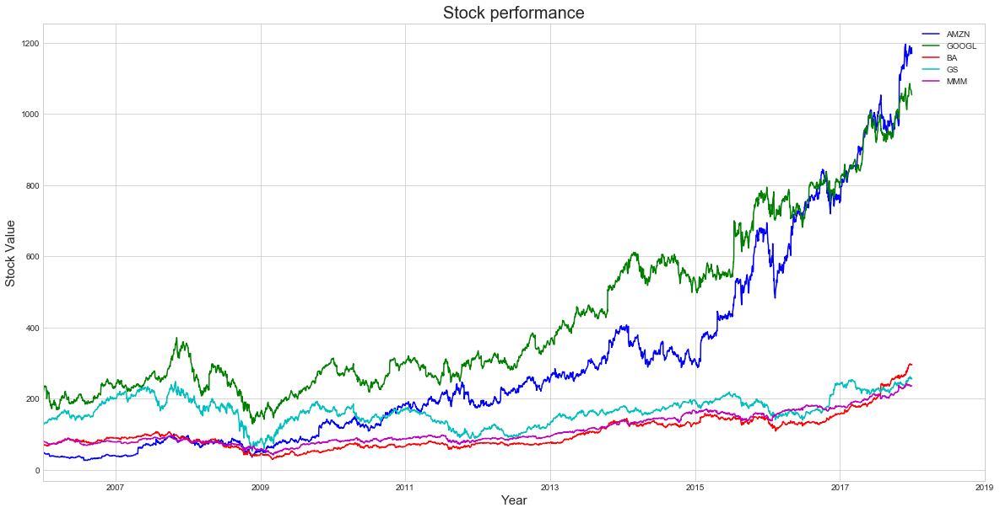

In [45]:
#plotting stock close values vs date
plt.figure(figsize=(20,10))
plt.plot(StockData[StockData['Name']=='AMZN']['Date'],StockData[StockData['Name']=='AMZN']['Close'],'b',label='AMZN')
plt.plot(StockData[StockData['Name']=='GOOGL']['Date'],StockData[StockData['Name']=='GOOGL']['Close'],'g',label='GOOGL')
plt.plot(StockData[StockData['Name']=='BA']['Date'],StockData[StockData['Name']=='BA']['Close'],'r',label='BA')
plt.plot(StockData[StockData['Name']=='GS']['Date'],StockData[StockData['Name']=='GS']['Close'],'c',label='GS')
plt.plot(StockData[StockData['Name']=='MMM']['Date'],StockData[StockData['Name']=='MMM']['Close'],'m',label='MMM')
plt.legend()
plt.xlabel('Year',fontsize=15)
plt.ylabel('Stock Value',fontsize=15)
plt.title('Stock performance',fontsize=20)
plt.xlim('2006','2019')

In [46]:
print('Amazon and Google have highest growth rate compare to others')

Amazon and Google have highest growth rate compare to others


In [47]:
test=StockData.pivot(index='Date', columns='Name', values='Close')[['AMZN','GOOGL','BA','GS','MMM']]
#test.iplot(theme='white', filename='Tutorial White', world_readable=True)
test.iplot(theme='white',yTitle='Stock Value',xTitle='Year')

In [48]:
volume=StockData.pivot(index='Date', columns='Name', values='Volume')[['AMZN','GOOGL','BA','GS','MMM']]
#test.iplot(theme='white', filename='Tutorial White', world_readable=True)
volume.iplot(theme='white',xTitle='Year',yTitle='Volume')

(732312.0, 736695.0)

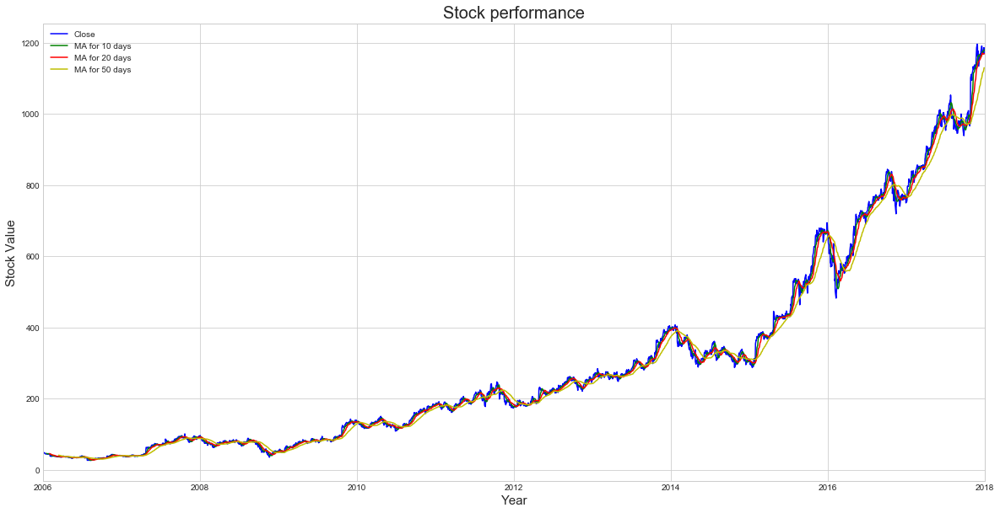

In [49]:
#comparing Rolling Mean of Amazon stock for 10,20 and 50days

AMZN=pd.read_csv('AMZN_2006-01-01_to_2018-01-01.csv')
AMZN['Date']=pd.to_datetime(AMZN['Date'])

ma_day = [10,20,50]

for ma in ma_day:
    column_name = "MA for %s days" %(str(ma))
    AMZN[column_name]=AMZN['Close'].rolling(ma).mean()
    

plt.figure(figsize=(20,10))
plt.plot(AMZN['Date'],AMZN['Close'],'b',label='Close')
plt.plot(AMZN['Date'],AMZN['MA for 10 days'],'g',label='MA for 10 days')
plt.plot(AMZN['Date'],AMZN['MA for 20 days'],'r',label='MA for 20 days')
plt.plot(AMZN['Date'],AMZN['MA for 50 days'],'y',label='MA for 50 days')
plt.legend()
plt.xlabel('Year',fontsize=15)
plt.ylabel('Stock Value',fontsize=15)
plt.title('Stock performance',fontsize=20)
plt.xlim('2006','2018')



(732312.0, 736695.0)

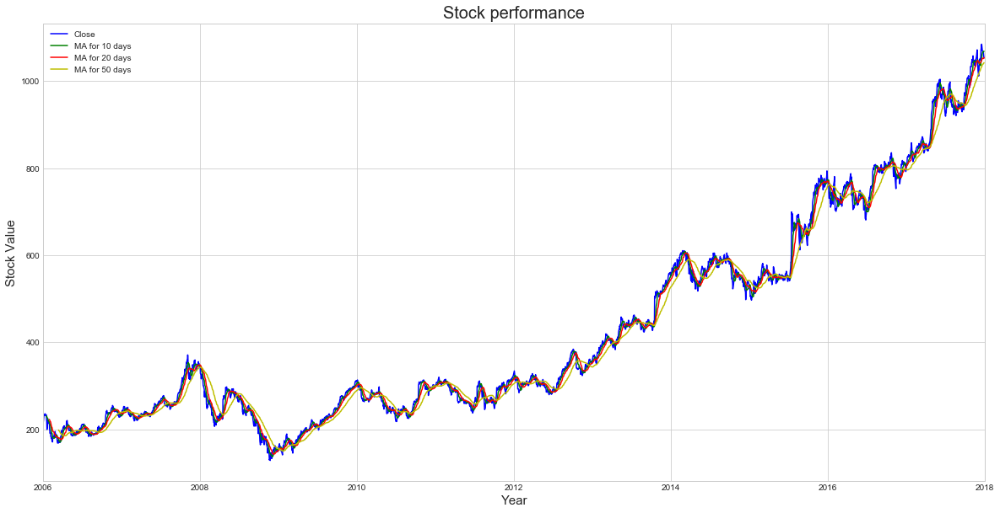

In [73]:
#comparing Rolling Mean of Google stock for 10,20 and 50 days

GOOGL=pd.read_csv('GOOGL_2006-01-01_to_2018-01-01.csv')
GOOGL['Date']=pd.to_datetime(GOOGL['Date'])

ma_day = [10,20,50]

for ma in ma_day:
    column_name = "MA for %s days" %(str(ma))
    GOOGL[column_name]=GOOGL['Close'].rolling(ma).mean()
    

plt.figure(figsize=(20,10))
plt.plot(GOOGL['Date'],GOOGL['Close'],'b',label='Close')
plt.plot(GOOGL['Date'],GOOGL['MA for 10 days'],'g',label='MA for 10 days')
plt.plot(GOOGL['Date'],GOOGL['MA for 20 days'],'r',label='MA for 20 days')
plt.plot(GOOGL['Date'],GOOGL['MA for 50 days'],'y',label='MA for 50 days')
plt.legend()
plt.xlabel('Year',fontsize=15)
plt.ylabel('Stock Value',fontsize=15)
plt.title('Stock performance',fontsize=20)
plt.xlim('2006','2018')



(732312.0, 736695.0)

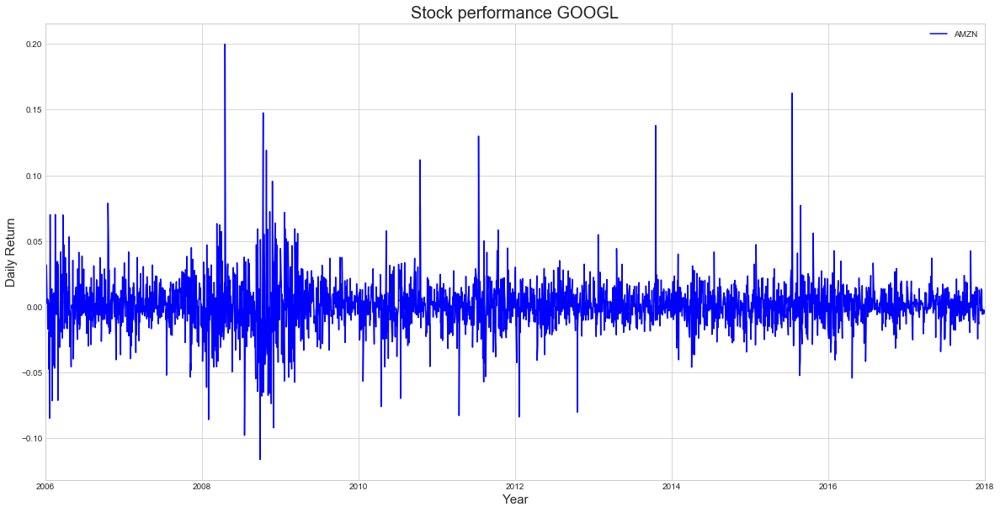

In [74]:
GOOGL['Daily Return'] = GOOGL['Close'].pct_change()
plt.figure(figsize=(20,10))
plt.plot(GOOGL['Date'],GOOGL['Daily Return'],'b',label='AMZN')
plt.legend()
plt.xlabel('Year',fontsize=15)
plt.ylabel('Daily Return',fontsize=15)
plt.title('Stock performance GOOGL',fontsize=20)
plt.xlim('2006','2018')

(732312.0, 736695.0)

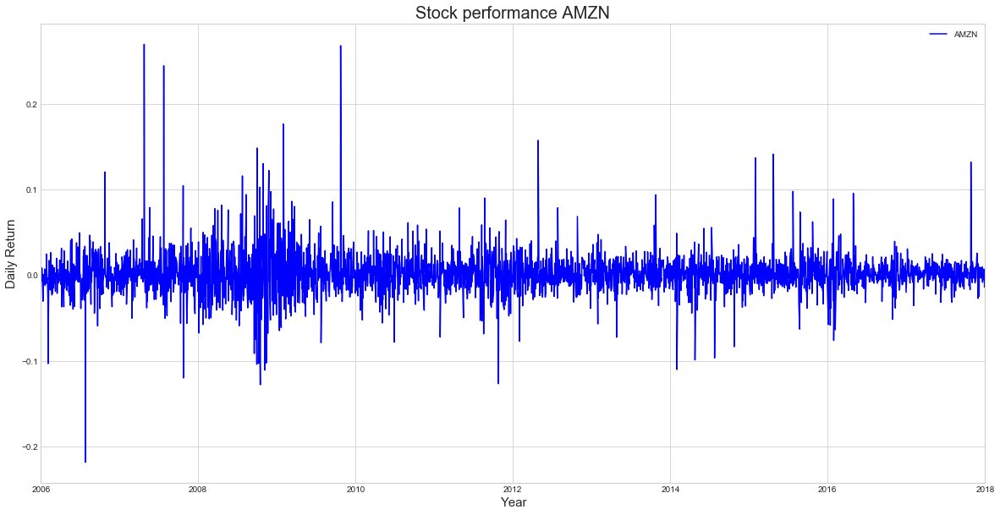

In [75]:
AMZN['Daily Return'] = AMZN['Close'].pct_change()
plt.figure(figsize=(20,10))
plt.plot(AMZN['Date'],AMZN['Daily Return'],'b',label='AMZN')
plt.legend()
plt.xlabel('Year',fontsize=15)
plt.ylabel('Daily Return',fontsize=15)
plt.title('Stock performance AMZN',fontsize=20)
plt.xlim('2006','2018')

In [52]:
#plotting candlestick plot for amazon stock for year 2017
AMZN=pd.read_csv('AMZN_2006-01-01_to_2018-01-01.csv')
AMZN['Date']=pd.to_datetime(AMZN['Date'])
AMZN=AMZN[AMZN['Date']>'2016-12-31']

trace=go.Candlestick(x=AMZN.Date,
                       open=AMZN.Open,
                       high=AMZN.High,
                       low=AMZN.Low,
                       close=AMZN.Close)
layout = {
    'title': 'Amazon',
    'yaxis': {'title': 'Amazon Stock'}
      
}

data = [trace]
fig = go.Figure(data=data,layout=layout)
iplot(fig)

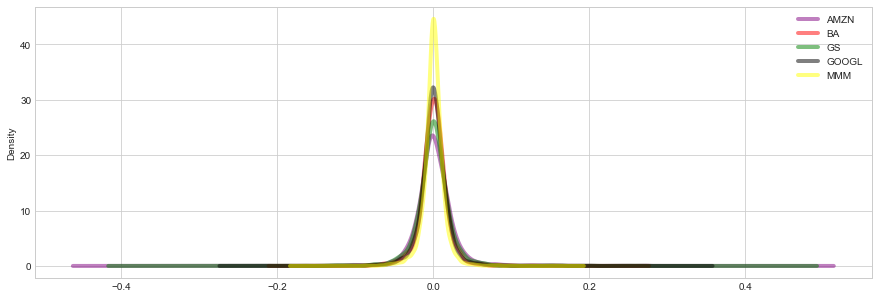

In [53]:
#lets compare the daily return of top 5 companies
AMZN=pd.read_csv('AMZN_2006-01-01_to_2018-01-01.csv')
MMM=pd.read_csv('MMM_2006-01-01_to_2018-01-01.csv')
BA=pd.read_csv('BA_2006-01-01_to_2018-01-01.csv')
GS=pd.read_csv('GS_2006-01-01_to_2018-01-01.csv')
GOOGL=pd.read_csv('GOOGL_2006-01-01_to_2018-01-01.csv')

AMZN['Daily Return'] = AMZN['Close'].pct_change()
MMM['Daily Return'] = MMM['Close'].pct_change()
BA['Daily Return'] = BA['Close'].pct_change()
GS['Daily Return'] = GS['Close'].pct_change()
GOOGL['Daily Return'] = GOOGL['Close'].pct_change()

plt.figure(figsize=(15,5))
AMZN['Daily Return'].plot.kde(label='AMZN',color='purple',alpha=0.5,linewidth =4)
BA['Daily Return'].plot.kde(label='BA',color='red',alpha=0.5,linewidth =4)
GS['Daily Return'].plot.kde(label='GS',color='green',alpha=0.5,linewidth =4)
GOOGL['Daily Return'].plot.kde(label='GOOGL',color='black',alpha=0.5,linewidth =4)
MMM['Daily Return'].plot.kde(label='MMM',color='yellow',alpha=0.5,linewidth =4)
plt.legend()

# It can be seen that 3M stocks are less volatile



In [44]:
# It can be seen that 3M stocks are less volatile

In [54]:
test=StockData.pivot(index='Date', columns='Name', values='Close')[StockData['Name'].unique()]
tech_rets = test.pct_change()

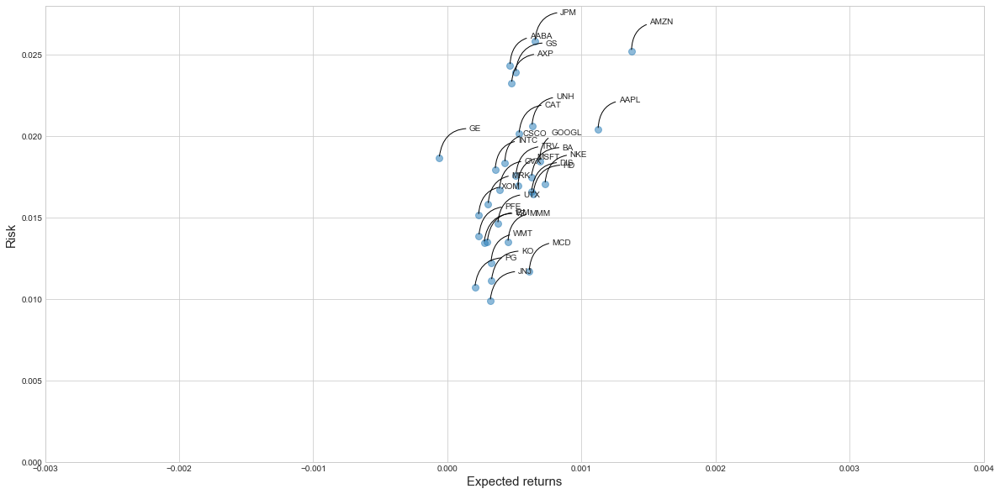

In [55]:
plt.figure(figsize=(20,10))
rets = tech_rets.dropna()

# Scatter plot of expected return of the stocks vs. their standard deviations of daily retunrs
area = np.pi*20

plt.scatter(rets.mean(), rets.std(),alpha = 0.5,s =area)

plt.ylim([0.00,0.028])
plt.xlim([-0.003,0.004])

plt.xlabel('Expected returns',fontsize=15)
plt.ylabel('Risk',fontsize=15)

for label, x, y in zip(rets.columns, rets.mean(), rets.std()):
    plt.annotate(
        label, 
        xy = (x, y), xytext = (50, 30),
        textcoords = 'offset points', ha = 'right', va = 'bottom',
        arrowprops = dict(arrowstyle = '-', connectionstyle = 'arc3,rad=0.5'))

In [56]:
AMZN=pd.read_csv('AMZN_2006-01-01_to_2018-01-01.csv')
MMM=pd.read_csv('MMM_2006-01-01_to_2018-01-01.csv')
BA=pd.read_csv('BA_2006-01-01_to_2018-01-01.csv')
GS=pd.read_csv('GS_2006-01-01_to_2018-01-01.csv')
GOOGL=pd.read_csv('GOOGL_2006-01-01_to_2018-01-01.csv')


AMZN['Date']=pd.to_datetime(AMZN['Date'])
MMM['Date']=pd.to_datetime(MMM['Date'])
BA['Date']=pd.to_datetime(BA['Date'])
GS['Date']=pd.to_datetime(GS['Date'])
GOOGL['Date']=pd.to_datetime(GOOGL['Date'])




Text(0.5,1,'Volume,Close vs Date(GOOGL)')

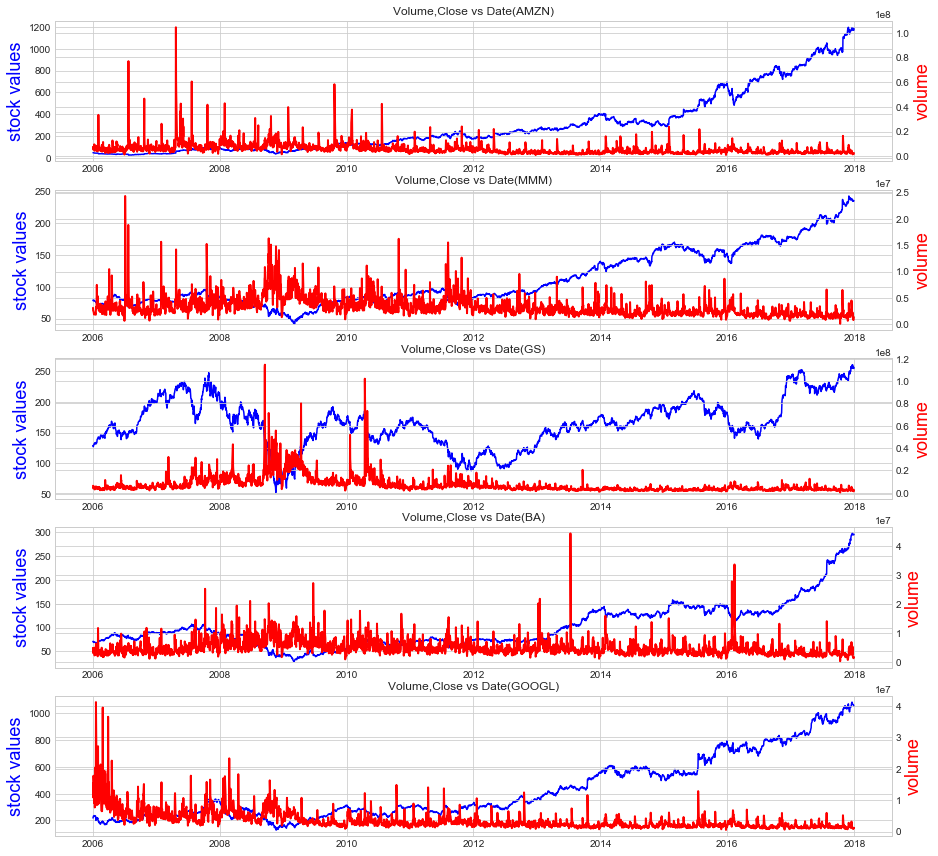

In [57]:
#plotting stocke close values and volume vs date for tope 5 companies.
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(15,15))
axes[0].plot('Date','Close',data=AMZN,color='blue')
axes[0].set_ylabel(r"stock values", fontsize=18, color="blue")
ax0 = axes[0].twinx()
ax0.plot('Date','Volume',data=AMZN, lw=2, color="red")
ax0.set_ylabel(r"volume", fontsize=18, color="red")
axes[0].set_title('Volume,Close vs Date(AMZN)')

axes[1].plot('Date','Close',data=MMM,color='blue')
axes[1].set_ylabel(r"stock values", fontsize=18, color="blue")
ax1 = axes[1].twinx()
ax1.plot('Date','Volume',data=MMM, lw=2, color="red")
ax1.set_ylabel(r"volume", fontsize=18, color="red")
axes[1].set_title('Volume,Close vs Date(MMM)')

axes[2].plot('Date','Close',data=GS,color='blue')
axes[2].set_ylabel(r"stock values", fontsize=18, color="blue")
ax2 = axes[2].twinx()
ax2.plot('Date','Volume',data=GS, lw=2, color="red")
ax2.set_ylabel(r"volume", fontsize=18, color="red")
axes[2].set_title('Volume,Close vs Date(GS)')

axes[3].plot('Date','Close',data=BA,color='blue')
axes[3].set_ylabel(r"stock values", fontsize=18, color="blue")
ax3 = axes[3].twinx()
ax3.plot('Date','Volume',data=BA, lw=2, color="red")
ax3.set_ylabel(r"volume", fontsize=18, color="red")
axes[3].set_title('Volume,Close vs Date(BA)')

axes[4].plot('Date','Close',data=GOOGL,color='blue')
axes[4].set_ylabel(r"stock values", fontsize=18, color="blue")
ax4 = axes[4].twinx()
ax4.plot('Date','Volume',data=GOOGL, lw=2, color="red")
ax4.set_ylabel(r"volume", fontsize=18, color="red")
axes[4].set_title('Volume,Close vs Date(GOOGL)')



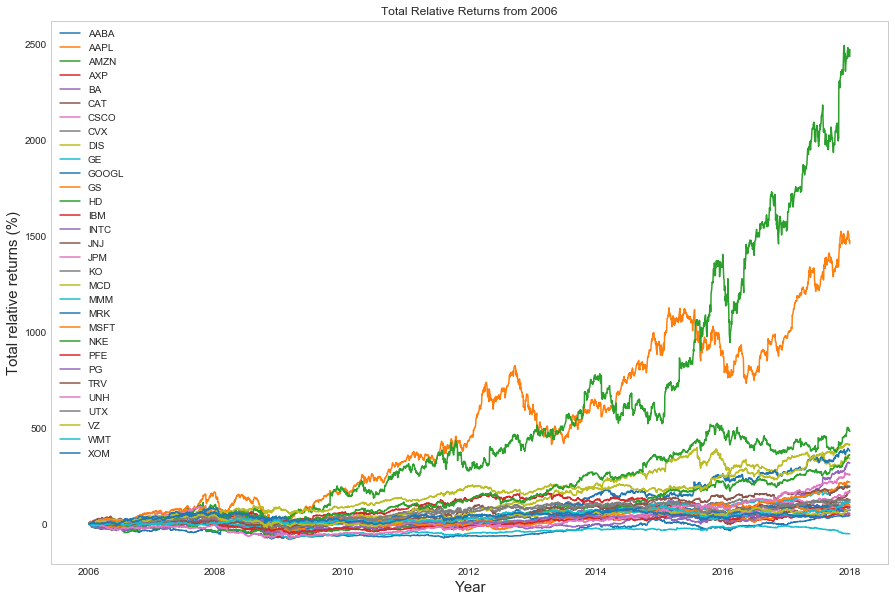

In [58]:
test2=StockData.pivot(index='Date', columns='Name', values='Close')

log_returns = np.log(test2).diff()


fig, ax = plt.subplots(figsize=(15,10))

for c in log_returns:
    ax.plot(log_returns.index, 100*(np.exp(log_returns[c].cumsum()) - 1), label=str(c))

ax.set_ylabel('Total relative returns (%)',fontsize=15)
ax.set_xlabel('Year',fontsize=15)
ax.set_title('Total Relative Returns from 2006')
ax.legend(loc='upper left')
ax.grid()

In [59]:
log_returns=log_returns.cumsum()
log_returns.iplot(theme='white',yTitle='Cumulative log returns',xTitle='Year',title='Cumulative log returns from 2006' )


In [60]:
#adding new column in data industry and adding instry according to company

Health_care=['MMM','JNJ','MRK','PFE','UNH']
Finance=['AXP','GS','JPM','TRV']
Technology=[ 'AAPL','CSCO','IBM','INTC','MSFT','GOOGL','AABA']
Capital_Goods=[ 'BA','CAT','UTX']
Energy=['CVX','XOM','GE']
Consumer_NonDurables=[ 'KO','NKE']
Consumer_Services=[ 'DIS','HD','MCD','WMT','AMZN']
Basic_Industries=['PG']
Public_Utilities=['VZ']

#function to return indusrty by company name

def industry(x):
    if x in Health_care:
        return 'Health_care'
    elif x in Finance:
        return 'Finance'
    elif x in Technology:
        return 'Technology'
    elif x in Capital_Goods:
        return 'Capital_Goods'
    elif x in Energy:
        return 'Energy'
    elif x in Consumer_NonDurables:
        return 'Consumer_NonDurables'
    elif x in Consumer_Services:
        return 'Consumer_Services'
    elif x in Basic_Industries:
        return 'Basic_Industries'
    else:
        return 'Public_Utilities'



StockData['Industry']=StockData['Name'].apply(industry)


In [61]:
StockData['Year']=StockData['Date'].apply(lambda x: x.year)

In [62]:
gpByIndustry=StockData.groupby(['Industry','Year'],as_index=False).mean()

In [63]:

trace_Health_care = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Health_care']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Health_care']['Open'],
    name='Health care'
)

trace_Finance = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Finance']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Finance']['Open'],
    name='Finance'
)

trace_Technology = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Technology']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Technology']['Open'],
    name='Technology'
)

trace_Capital_Goods = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Capital_Goods']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Capital_Goods']['Open'],
    name='Capital Goods'
)

trace_Energy = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Energy']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Energy']['Open'],
    name='Energy'
)

trace_Consumer_NonDurables = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Consumer_NonDurables']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Consumer_NonDurables']['Open'],
    name='Consumer Non Durables'
)

trace_Consumer_Services = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Consumer_Services']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Consumer_Services']['Open'],
    name='Consumer Services'
)

trace_Basic_Industries = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Basic_Industries']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Basic_Industries']['Open'],
    name='Basic Industries'
)

trace_Public_Utilities = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Public_Utilities']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Public_Utilities']['Open'],
    name='Public Utilities'
)

data = [trace_Health_care,trace_Finance,trace_Technology,trace_Capital_Goods,trace_Energy,
        trace_Consumer_NonDurables,trace_Consumer_Services,trace_Basic_Industries,trace_Public_Utilities]

layout= go.Layout(
    title='Average Stock Price vs Year',
    hovermode='closest',
    xaxis=dict(
        title='Year',
        ticklen=5,
        zeroline=False,
        gridwidth=2,
    ),
    yaxis=dict(
        title='Average Stockprice',
        ticklen=5,
        gridwidth=2,
    ),
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)




In [64]:


trace_Health_care = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Health_care']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Health_care']['Volume'],
    name='Health care'
)

trace_Finance = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Finance']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Finance']['Volume'],
    name='Finance'
)

trace_Technology = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Technology']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Technology']['Volume'],
    name='Technology'
)

trace_Capital_Goods = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Capital_Goods']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Capital_Goods']['Volume'],
    name='Capital Goods'
)

trace_Energy = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Energy']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Energy']['Volume'],
    name='Energy'
)

trace_Consumer_NonDurables = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Consumer_NonDurables']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Consumer_NonDurables']['Volume'],
    name='Consumer Non Durables'
)

trace_Consumer_Services = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Consumer_Services']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Consumer_Services']['Volume'],
    name='Consumer Services'
)

trace_Basic_Industries = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Basic_Industries']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Basic_Industries']['Volume'],
    name='Basic Industries'
)

trace_Public_Utilities = go.Scatter(
    x=gpByIndustry[gpByIndustry['Industry']=='Public_Utilities']['Year'],
    y=gpByIndustry[gpByIndustry['Industry']=='Public_Utilities']['Volume'],
    name='Public Utilities'
)

data = [trace_Health_care,trace_Finance,trace_Technology,trace_Capital_Goods,trace_Energy,
        trace_Consumer_NonDurables,trace_Consumer_Services,trace_Basic_Industries,trace_Public_Utilities]

layout= go.Layout(
    title='Average Stock Volume vs year',
    hovermode='closest',
    xaxis=dict(
        title='Year',
        ticklen=5,
        zeroline=False,
        gridwidth=2,
    ),
    yaxis=dict(
        title='Average Volume',
        ticklen=5,
        gridwidth=2,
    ),
)


fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [65]:
# function to calcularte RSI

def RSI(df, column="Close", period=14):
    # wilder's RSI
 
    delta = df[column].diff()
    up, down = delta.copy(), delta.copy()

    up[up < 0] = 0
    down[down > 0] = 0

    rUp = up.ewm(com=period - 1,  adjust=False).mean()
    rDown = down.ewm(com=period - 1, adjust=False).mean().abs()

    rsi = 100 - 100 / (1 + rUp / rDown)    

    return df.join(rsi.to_frame('RSI'))

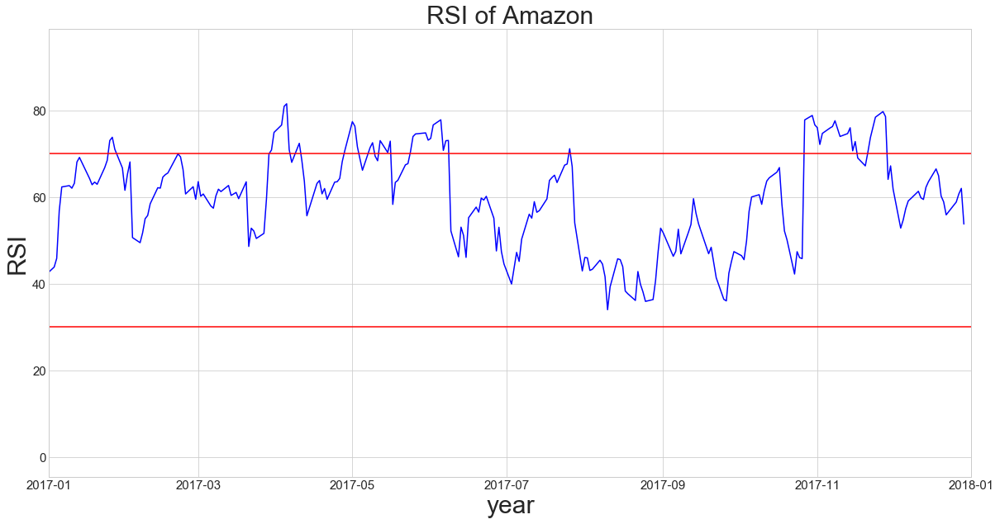

In [66]:
RSIdf=RSI(AMZN)
plt.figure(figsize=(20,10))
plt.plot(RSIdf['Date'], RSIdf['RSI'], 'b') # 'r' is the color red
plt.xlabel('year',fontsize=30)
plt.ylabel('RSI',fontsize=30)
plt.title('RSI of Amazon',fontsize=30)
plt.xlim('2017','2018')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axhline(30,color='r')
plt.axhline(70,color='r')

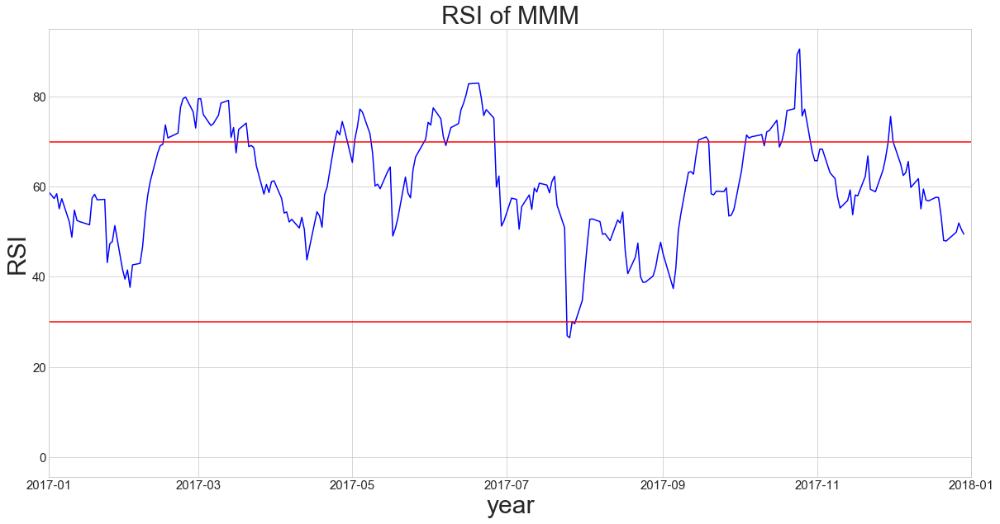

In [67]:
RSIdf=RSI(MMM)
plt.figure(figsize=(20,10))
plt.plot(RSIdf['Date'], RSIdf['RSI'], 'b') # 'r' is the color red
plt.xlabel('year',fontsize=30)
plt.ylabel('RSI',fontsize=30)
plt.title('RSI of MMM',fontsize=30)
plt.xlim('2017','2018')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axhline(30,color='r')
plt.axhline(70,color='r')

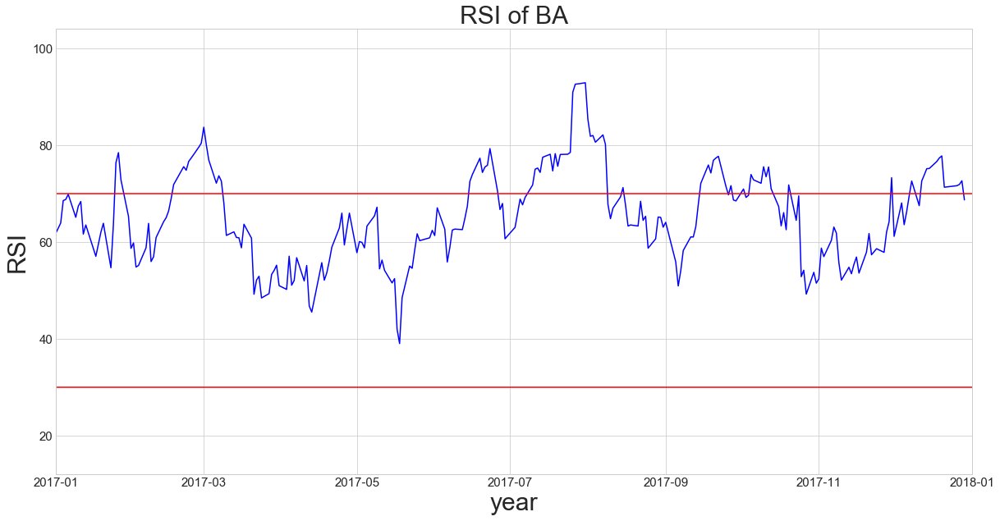

In [68]:
RSIdf=RSI(BA)
plt.figure(figsize=(20,10))
plt.plot(RSIdf['Date'], RSIdf['RSI'], 'b') # 'r' is the color red
plt.xlabel('year',fontsize=30)
plt.ylabel('RSI',fontsize=30)
plt.title('RSI of BA',fontsize=30)
plt.xlim('2017','2018')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axhline(30,color='r')
plt.axhline(70,color='r')

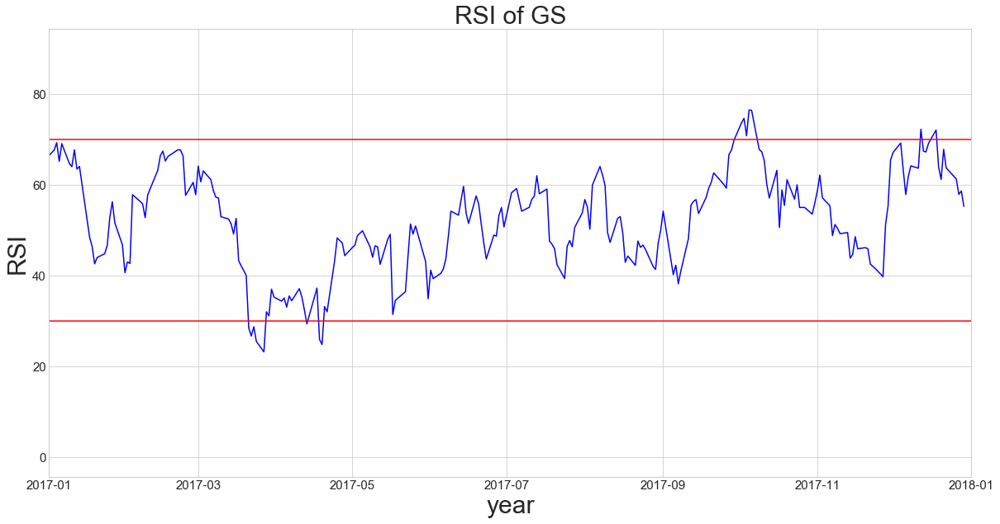

In [69]:
RSIdf=RSI(GS)
plt.figure(figsize=(20,10))
plt.plot(RSIdf['Date'], RSIdf['RSI'], 'b') # 'r' is the color red
plt.xlabel('year',fontsize=30)
plt.ylabel('RSI',fontsize=30)
plt.title('RSI of GS',fontsize=30)
plt.xlim('2017','2018')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axhline(30,color='r')
plt.axhline(70,color='r')

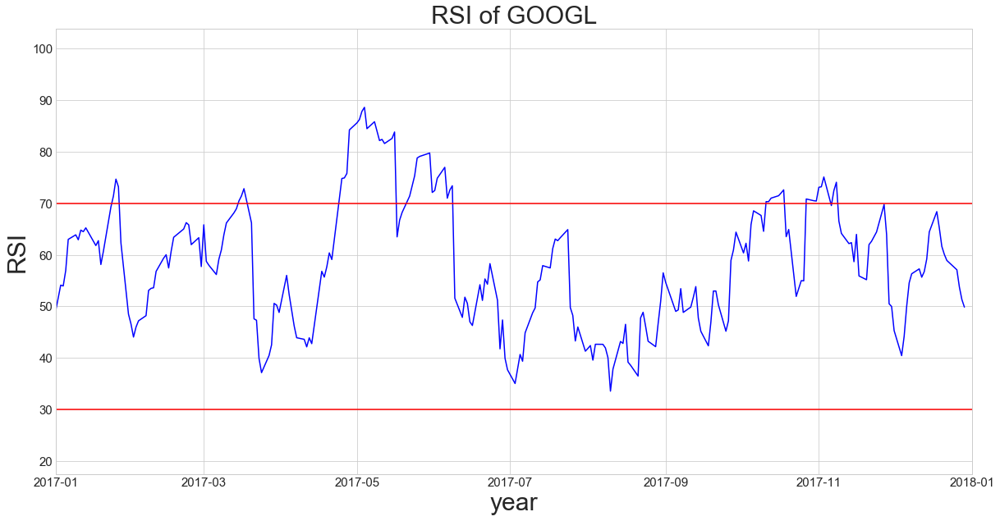

In [70]:
RSIdf=RSI(GOOGL)
plt.figure(figsize=(20,10))
plt.plot(RSIdf['Date'], RSIdf['RSI'], 'b') # 'r' is the color red
plt.xlabel('year',fontsize=30)
plt.ylabel('RSI',fontsize=30)
plt.title('RSI of GOOGL',fontsize=30)
plt.xlim('2017','2018')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axhline(30,color='r')
plt.axhline(70,color='r')